In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import sqlite3
import numpy as np
from SlideRunner.dataAccess.database import Database
from tqdm import tqdm
from pathlib import Path
import openslide
import time

In [3]:
from fastai import *
from fastai.vision import *
from fastai.callbacks import *
from random import randint

In [4]:
from data_loader import *
from callbacks.callbacks import BBLossMetrics, BBMetrics, PascalVOCMetric
from helper.object_detection_helper import *
from loss.RetinaNetFocalLoss import RetinaNetFocalLoss
from models.RetinaNet import RetinaNet
from eiph_callbacks import PascalVOCMetricByDistance

In [5]:
path = Path('/data/Datasets/EIPH_WSI/')

database = Database()
database.open(str(path/'EIPH.sqlite'))

size = 1024

In [6]:
files = []
lbl_bbox = []

getslides = """SELECT uid, filename FROM Slides"""
for currslide, filename in tqdm(database.execute(getslides).fetchall()):
    database.loadIntoMemory(currslide)

    check = True if 'erliner' in filename else False
    slidetype = 'Berliner Blau/' if check else 'Turnbull Blue/'

    slide_path = path / slidetype / filename

    slide = openslide.open_slide(str(slide_path))
    level = 0#slide.level_count - 1
    level_dimension = slide.level_dimensions[level]
    down_factor = slide.level_downsamples[level]

    classes = {3: 1, 4: 2, 5: 3, 6: 4, 7: 5}
    labels, bboxes = [], []
    for id, annotation in database.annotations.items():
        if annotation.labels[0].classId in classes:
            d = 2 * annotation.r / down_factor
            x_min = (annotation.x1 - annotation.r) / down_factor
            y_min = (annotation.y1 - annotation.r) / down_factor
            x_max = x_min + d
            y_max = y_min + d
            label = classes[annotation.labels[0].classId]

            bboxes.append([int(x_min), int(y_min), int(x_max), int(y_max)])
            labels.append(label)

    if len(bboxes) > 0:
        lbl_bbox.append([bboxes, labels])
        files.append(SlideContainer(slide_path, y=[bboxes, labels],  level=level, width=size, height=size))

  0%|          | 0/24 [00:00<?, ?it/s]

Loading DB into memory ...


  4%|▍         | 1/24 [00:00<00:10,  2.18it/s]

Loading DB into memory ...


  8%|▊         | 2/24 [00:01<00:20,  1.07it/s]

Loading DB into memory ...


 12%|█▎        | 3/24 [00:02<00:16,  1.24it/s]

Loading DB into memory ...


 21%|██        | 5/24 [00:03<00:11,  1.61it/s]

Loading DB into memory ...
Loading DB into memory ...
Loading DB into memory ...


 29%|██▉       | 7/24 [00:03<00:08,  1.96it/s]

Loading DB into memory ...


 38%|███▊      | 9/24 [00:03<00:06,  2.26it/s]

Loading DB into memory ...
Loading DB into memory ...


 46%|████▌     | 11/24 [00:04<00:04,  2.64it/s]

Loading DB into memory ...
Loading DB into memory ...


 62%|██████▎   | 15/24 [00:04<00:02,  3.25it/s]

Loading DB into memory ...
Loading DB into memory ...
Loading DB into memory ...
Loading DB into memory ...
Loading DB into memory ...


 79%|███████▉  | 19/24 [00:05<00:01,  3.44it/s]

Loading DB into memory ...
Loading DB into memory ...
Loading DB into memory ...
Loading DB into memory ...


 88%|████████▊ | 21/24 [00:06<00:00,  3.42it/s]

Loading DB into memory ...
Loading DB into memory ...


100%|██████████| 24/24 [00:07<00:00,  3.32it/s]

Loading DB into memory ...


In [7]:
img2bbox = dict(zip(files, np.array(lbl_bbox)))
get_y_func = lambda o:img2bbox[o]

In [8]:
bs = 20
train_images = 5000
val_images = 1000

train_files = list(np.random.choice(files[4:], train_images))
valid_files = list(np.random.choice(files[:4], val_images))

#train_files = list(np.random.choice(files, train_images))
#valid_files = list(np.random.choice(files, val_images))

In [9]:
tfms = get_transforms(do_flip=True,
                      flip_vert=True,
                      #max_rotate=90,
                      max_lighting=0.0,
                      max_zoom=1.,
                      max_warp=0.0,
                      p_affine=0.5,
                      p_lighting=0.0,
                      #xtra_tfms=xtra_tfms,
                     )
tfms

([RandTransform(tfm=TfmCrop (crop_pad), kwargs={'row_pct': (0, 1), 'col_pct': (0, 1), 'padding_mode': 'reflection'}, p=1.0, resolved={}, do_run=True, is_random=True),
  RandTransform(tfm=TfmAffine (dihedral_affine), kwargs={}, p=1.0, resolved={}, do_run=True, is_random=True),
  RandTransform(tfm=TfmAffine (rotate), kwargs={'degrees': (-10.0, 10.0)}, p=0.5, resolved={}, do_run=True, is_random=True)],
 [RandTransform(tfm=TfmCrop (crop_pad), kwargs={}, p=1.0, resolved={}, do_run=True, is_random=True)])

In [10]:
train =  ObjectItemListSlide(train_files, path=path)
valid = ObjectItemListSlide(valid_files, path=path)
item_list = ItemLists(path, train, valid)
lls = item_list.label_from_func(get_y_func, label_cls=SlideObjectCategoryList) #
lls = lls.transform(tfms, tfm_y=True, size=size)
data = lls.databunch(bs=bs, collate_fn=bb_pad_collate).normalize()

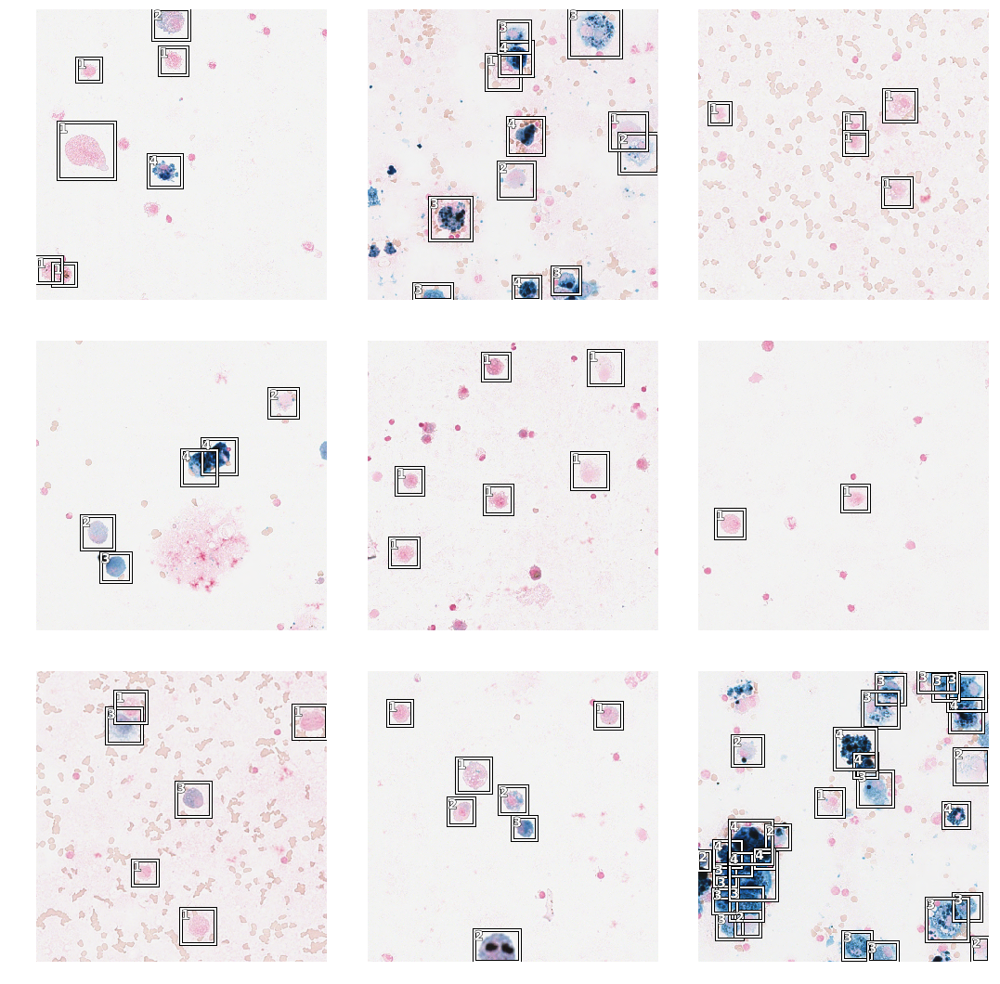

In [24]:
data.show_batch(rows=3, ds_type=DatasetType.Train, figsize=(15,15))

In [11]:
anchors_32 = create_anchors(sizes=[(32,32)], ratios=[1], scales=[0.6, 0.7, 0.9, 1.25, 1.5])

In [12]:
anchors = anchors_32

In [14]:
anchors

tensor([[-0.9688, -0.9688,  0.1500,  0.1500],
        [-0.9688, -0.9688,  0.1750,  0.1750],
        [-0.9688, -0.9688,  0.2250,  0.2250],
        ...,
        [ 0.9688,  0.9688,  0.2250,  0.2250],
        [ 0.9688,  0.9688,  0.3125,  0.3125],
        [ 0.9688,  0.9688,  0.3750,  0.3750]])

In [25]:
#anchors_16 = create_anchors(sizes=[(16,16)], ratios=[1], scales=[0,.25, 0.35, 0.46, 0.64])

In [26]:
#anchors = anchors_16

In [27]:
#anchors

tensor([[-0.9375, -0.9375,  0.0000,  0.0000],
        [-0.9375, -0.9375,  0.1250,  0.1250],
        [-0.9375, -0.9375,  0.1750,  0.1750],
        ...,
        [ 0.9375,  0.9375,  0.1750,  0.1750],
        [ 0.9375,  0.9375,  0.2300,  0.2300],
        [ 0.9375,  0.9375,  0.3200,  0.3200]])

/home/c.marzahl@de.eu.local/anaconda3/envs/fastai/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


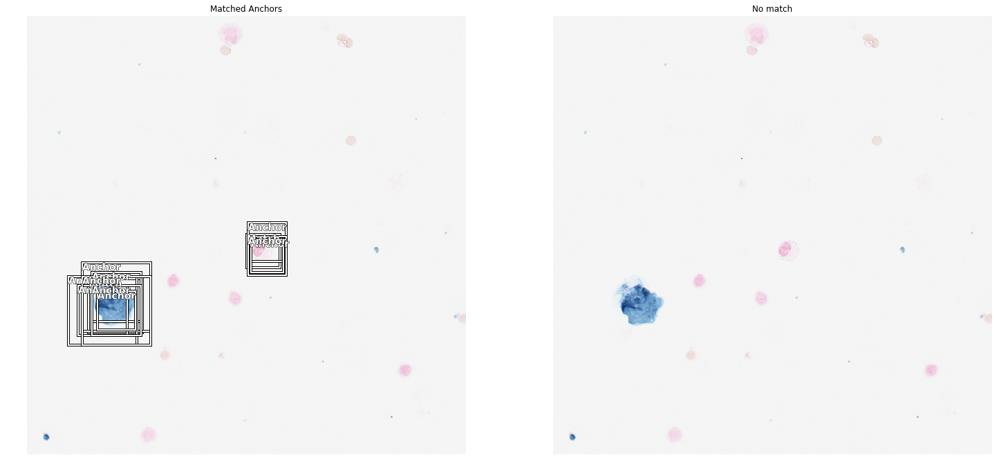

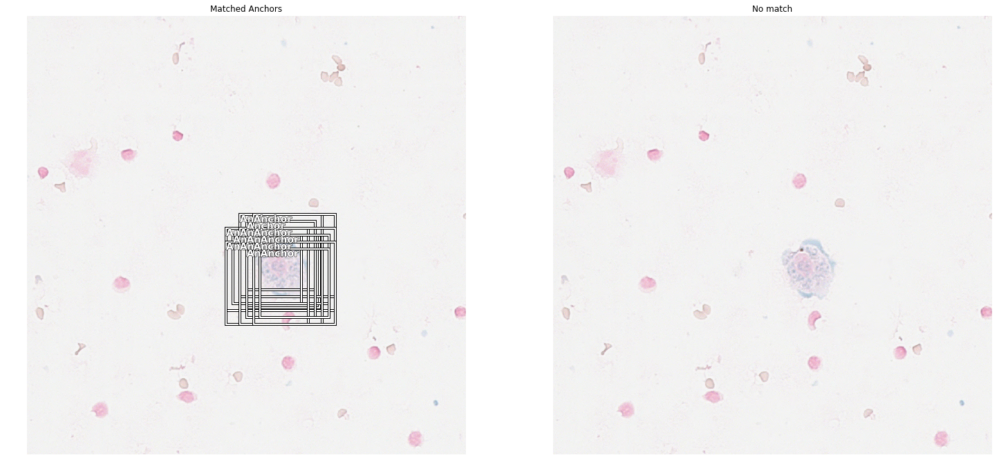

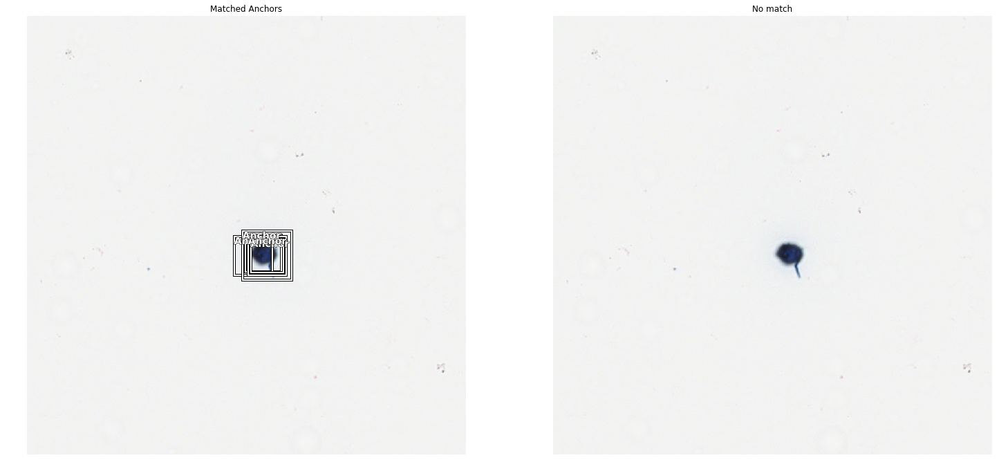

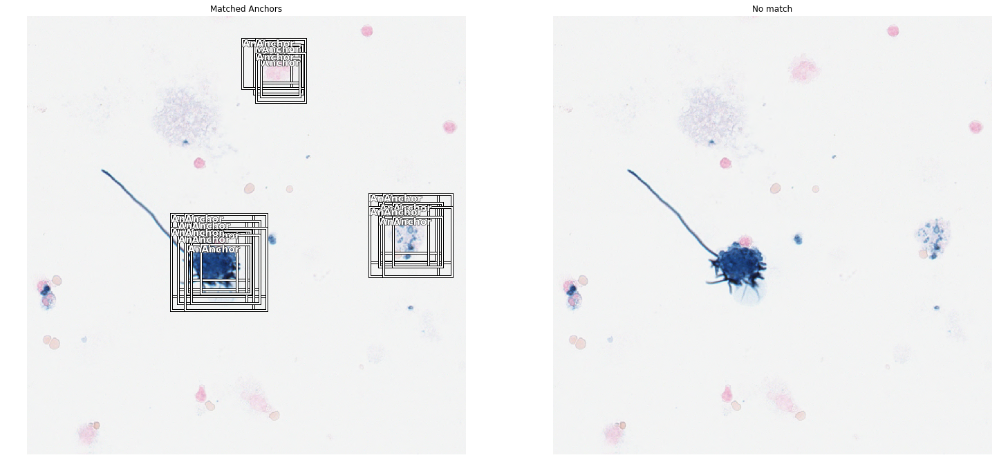

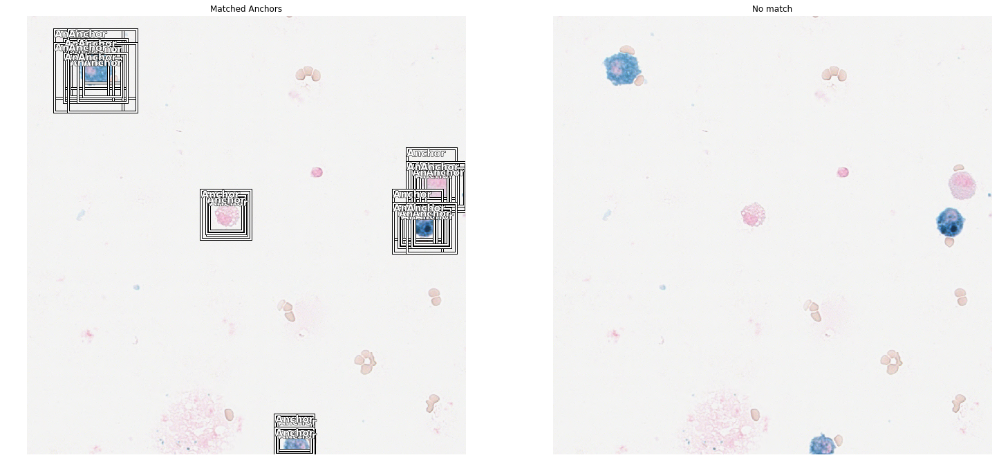

...

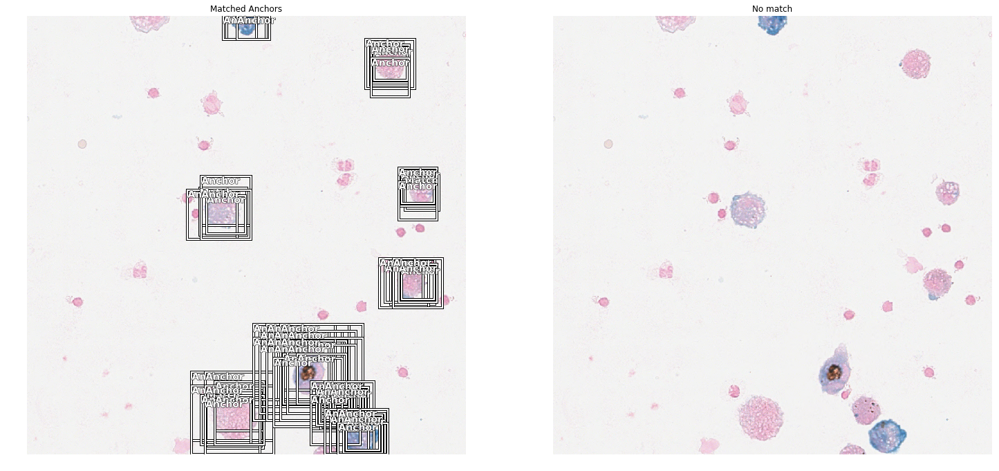

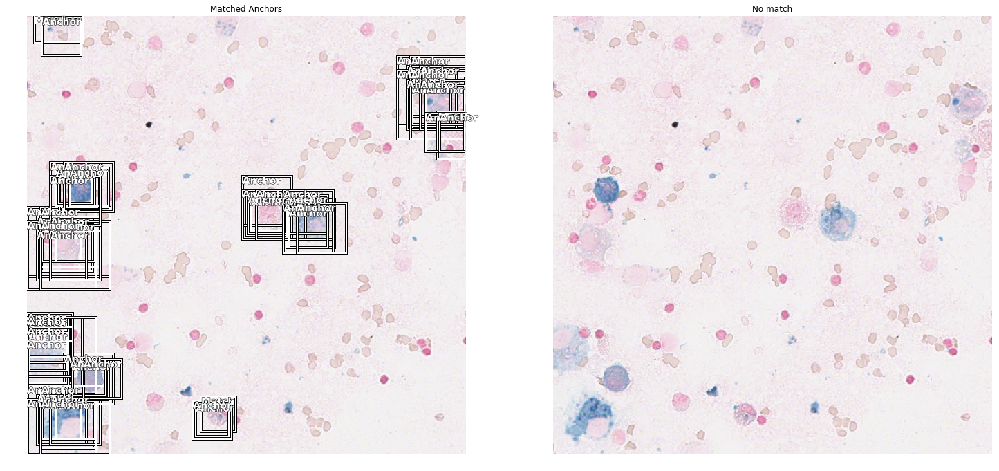

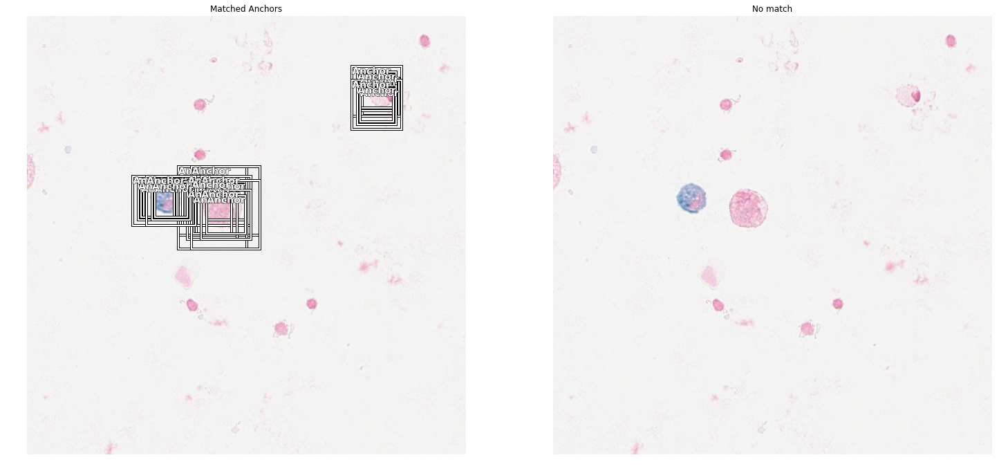

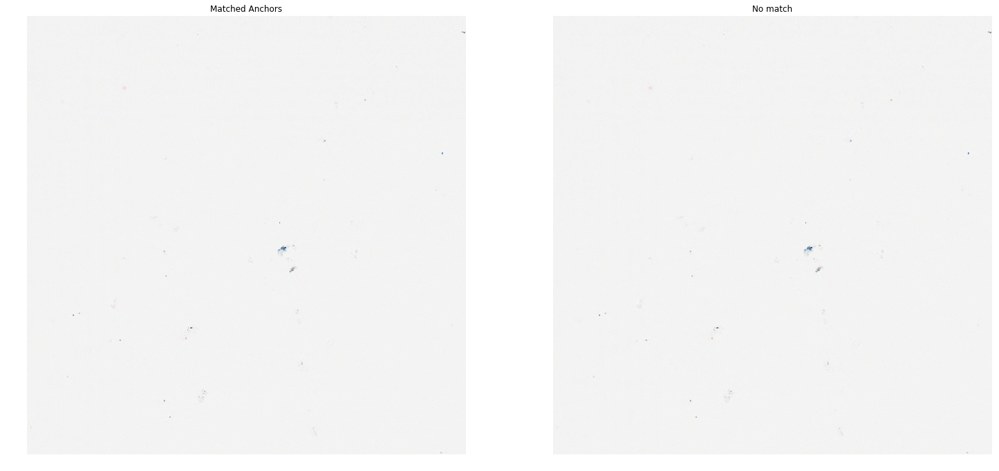

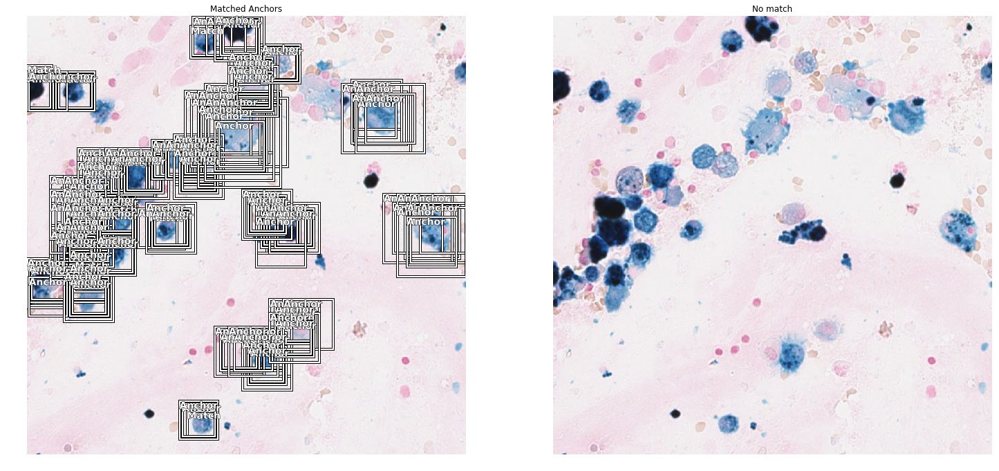

In [32]:
all_boxes, all_labels = show_anchors_on_images(data, anchors, figsize=(25,25))

In [23]:
anchors.shape

torch.Size([768, 4])

In [24]:
#anchors = torch.cat((anchors_32, anchors_16), 0)

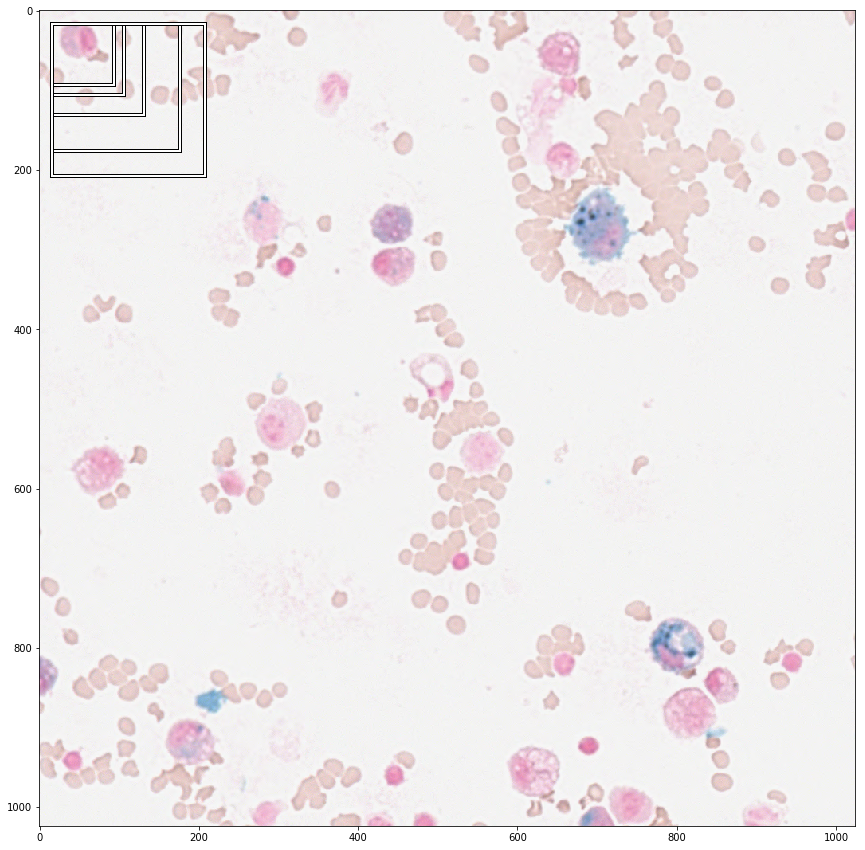

In [20]:
fig,ax = plt.subplots(figsize=(15,15))
ax.imshow(image2np(data.valid_ds[0][0].data))

for i, bbox in enumerate(anchors[:5]):
    bb = bbox.numpy()
    x = (bb[0] + 1) * size / 2 
    y = (bb[1] + 1) * size / 2 
    w = bb[2] * size / 2
    h = bb[3] * size / 2
    
    rect = [x,y,w,h]
    draw_rect(ax,rect)

In [13]:
crit = RetinaNetFocalLoss(anchors)

In [14]:
encoder = create_body(models.resnet18, True, -2)
model = RetinaNet(encoder, n_classes=data.train_ds.c, n_anchors=5, sizes=[32], chs=32, final_bias=-4., n_conv=1)

In [15]:
voc = PascalVOCMetricByDistance(anchors, size, [str(i-1) for i in data.train_ds.y.classes[1:]], radius=25)
learn = Learner(data, model, loss_func=crit, callback_fns=[BBMetrics], #BBMetrics, ShowGraph
                metrics=[voc]
               )

In [16]:
learn.split([model.encoder[6], model.c5top5])
learn.freeze_to(-2)

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


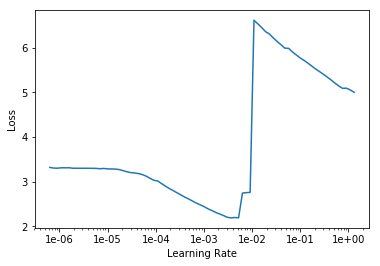

In [37]:
learn.lr_find()
learn.recorder.plot()

In [17]:
learn.fit_one_cycle(3, 1e-3)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-0,AP-1,AP-2,AP-3,AP-4,time
0,0.461364,0.367474,0.461320,0.117144,0.250331,0.621718,0.592423,0.407538,0.230798,0.454125,06:29
1,0.287985,0.272306,0.491422,0.080977,0.191329,0.702979,0.601704,0.486463,0.274916,0.391047,09:15
2,0.229945,0.251004,0.567059,0.070709,0.180295,0.769579,0.665531,0.542426,0.472553,0.385207,08:46


In [18]:
learn.data.stats

[tensor([0.9047, 0.9046, 0.9210]), tensor([0.1548, 0.1217, 0.0867])]

In [19]:
data.train_ds.classes

['background', 1, 2, 3, 4, 5]

In [20]:
learn.unfreeze()
learn.fit_one_cycle(10, 1e-3)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-0,AP-1,AP-2,AP-3,AP-4,time
0,0.232789,0.284676,0.555456,0.084963,0.199713,0.750474,0.594557,0.533545,0.397448,0.501253,08:57
1,0.269525,0.276602,0.473818,0.079016,0.197586,0.643313,0.696693,0.385691,0.404966,0.238427,17:05
2,0.307981,0.313230,0.473520,0.089690,0.223540,0.684496,0.715423,0.523634,0.210774,0.233272,22:05
3,0.258397,0.344995,0.423996,0.075548,0.269446,0.687439,0.379400,0.389669,0.293113,0.370361,24:33
4,0.244528,0.271142,0.557860,0.077408,0.193734,0.712264,0.673699,0.498380,0.317003,0.587956,23:22
5,0.210622,0.248910,0.562035,0.064471,0.184439,0.802285,0.625945,0.535348,0.372998,0.473601,20:29
6,0.195225,0.247401,0.602148,0.071207,0.176194,0.760550,0.668728,0.526087,0.519341,0.536033,14:36
7,0.174585,0.221778,0.615246,0.064256,0.157522,0.773919,0.684364,0.532050,0.533803,0.552095,06:32
8,0.167164,0.225759,0.587600,0.057805,0.167953,0.794379,0.657434,0.560947,0.496706,0.428535,06:30
9,0.158285,0.218488,0.599700,0.058772,0.159717,0.803296,0.689383,0.581147,0.493655,0.431021,06:31


In [ ]:
learn.fit_one_cycle(10, 1e-3)

In [38]:
#learn.save("pferd")
#learn.export("pferd_1024_16")

In [35]:
classes = data.train_ds.classes

In [36]:
classes

['background', 1, 2, 3, 4, 5]

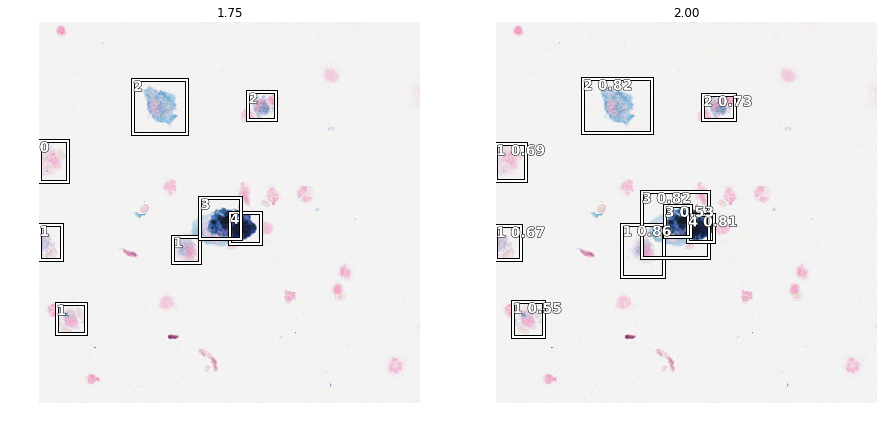

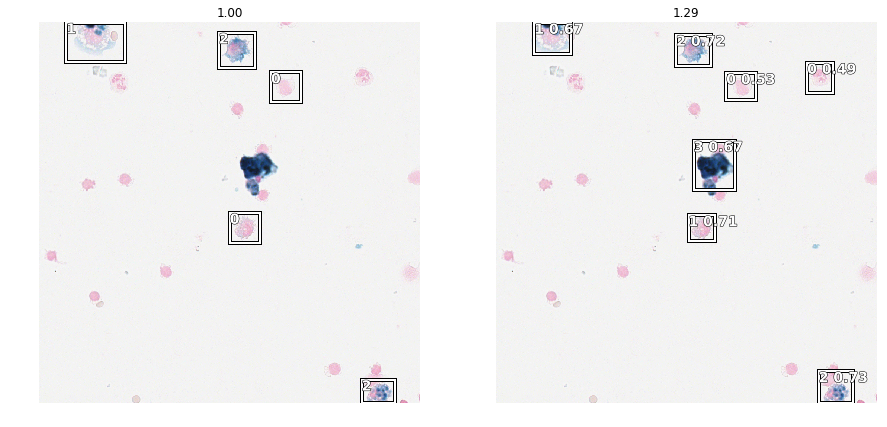

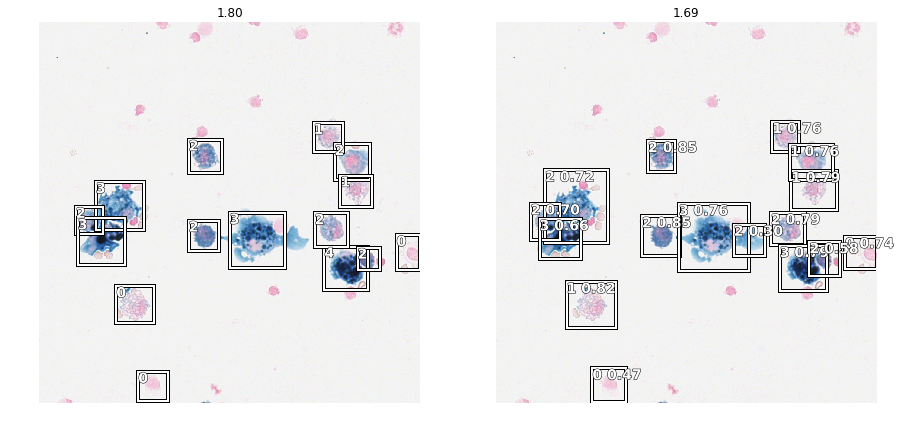

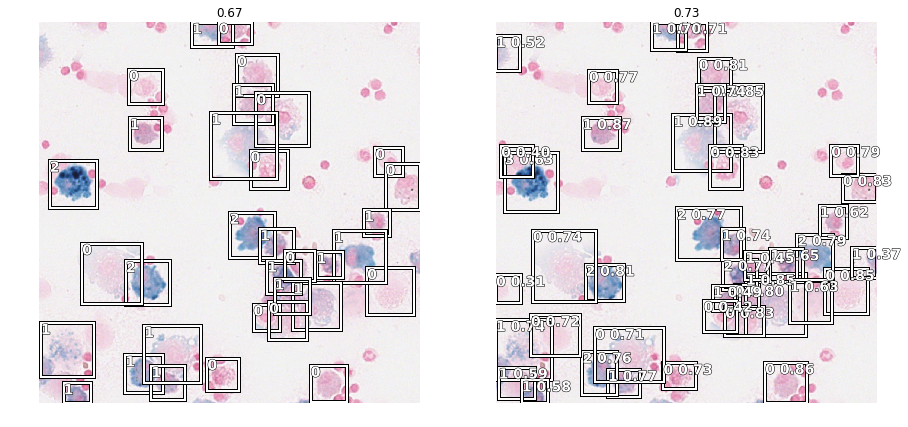

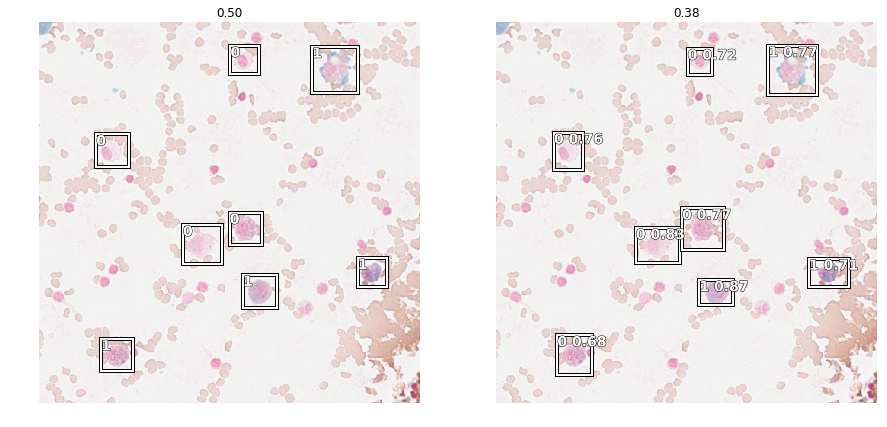

...

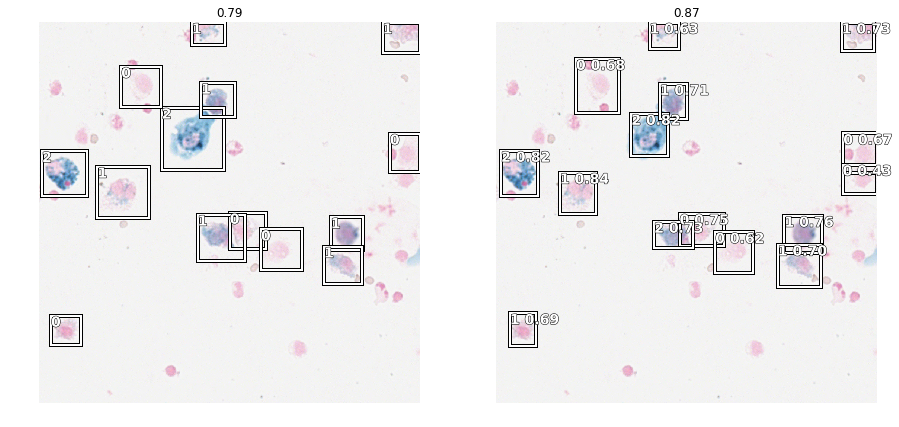

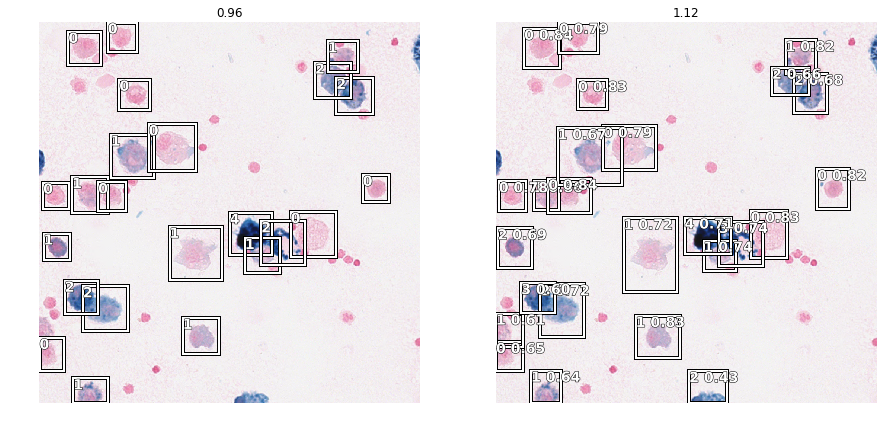

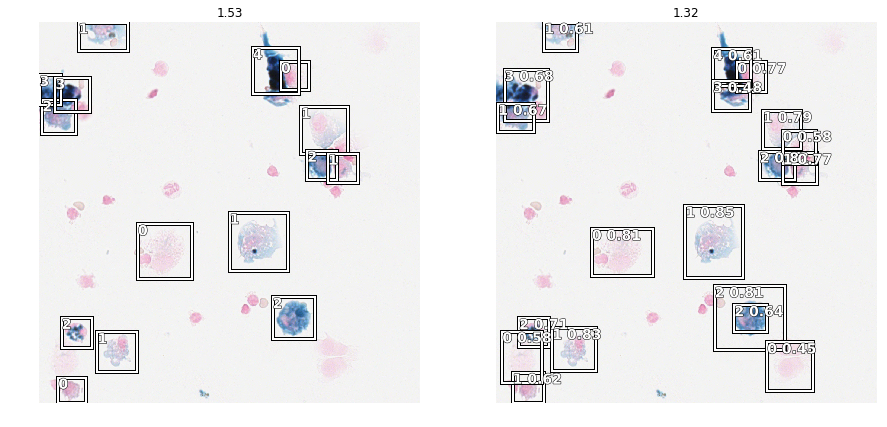

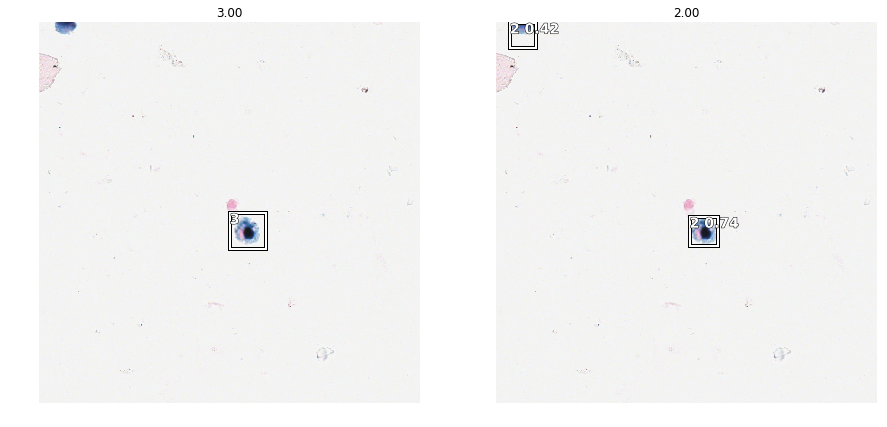

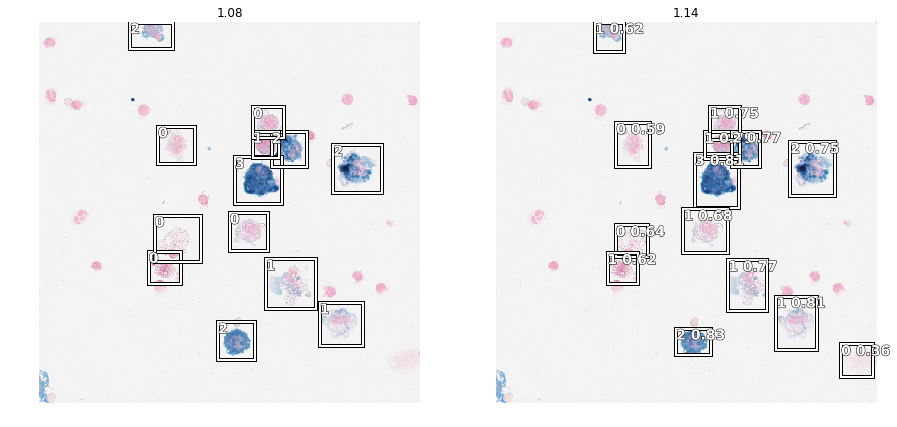

In [26]:
slide_object_result(learn, anchors, detect_thresh=0.3, nms_thresh=0.2, image_count=20)